# CSCA-5642: Final Project #
#### Develop an multi-class classifier to recognize action from video clips. ####
    
* Author: Alexander Meau  
* Email: alme9155@colorado.edu  
* GitHub: [https://github.com/alme9155/csca-5642-week4/tree/main](https://github.com/alme9155/csca-5642-week4/tree/main)  

<imag src="https://storage.googleapis.com/kaggle-datasets-images/2232355/3733921/1aa7cf2963836e7be0a22c2888d60b87/dataset-cover.jpg?t=2022-06-02-06-19-02" alt="." width="300">

## I. Brief description of the problem and data ##

This project explores the application of deep neural networks for human action recognition (HAR) in video sequences. Human action recognition has a wide range of practical applications, including sports analytics, robotics, and surveillance systems. By leveraging architectures such as CNN+LSTM and 3D Convolutional Networks (C3D), this study aims to compare the effectiveness of different algorithmic designs. Key challenges include modeling long-term temporal dependencies and handling variations in video length, lighting conditions, and resolution.

### Dataset: ####
* The UCF50 dataset is a collection of video clips of 50 different human action classes, such as Baseball pitch, kayaking, diving, etc to be examine huamn action recogntion with computer vision neural technology.
* The UCF50 dataset is a reduced dataset containing 50 of original 101 action classes from the the UCF101 action recognition dataset created by University of Central Florida, Center for Research in Computer Vision. Ref: [https://www.crcv.ucf.edu/data/UCF101.php](https://www.crcv.ucf.edu/data/UCF101.php).

### Data Size and Dimension ####
* Training dataset: 220,025 tiff images
* Test dataset: 57,458 tiff images (~26% of training size)
* Each image patch is 96x96 pixel of RGB color images in tiff formats.
* Label CSV contains 2 columns: id, label (1 as cancerous, 0 as non-cancerous)


In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
avi_files = []
total_avi_file_count =0

for dirname, _, filenames in os.walk('/kaggle/input'):
    #print(f"os path: [{dirname}]")
    avi_file_count =0
    for filename in filenames:
        if filename.endswith('.avi'):
            avi_file_count +=1
            # if avi_file_count < 3:
            #     print("\t"+os.path.join(dirname, filename))
            # elif avi_file_count == 3:
            #     print("\t...")
        else:
            print(os.path.join(dirname, filename))  
    if avi_file_count > 0:
        print(f"[{dirname}]:{avi_file_count} .avi files.")
        total_avi_file_count +=avi_file_count
        avi_file_count =0
print(f"\nTotal .avi file count = {total_avi_file_count}")
        
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

[/kaggle/input/ucf50-latest-version/UCF50/HorseRace]:127 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/VolleyballSpiking]:116 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/Biking]:145 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/TaiChi]:100 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/Punch]:160 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/BreastStroke]:101 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/Billiards]:150 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/PoleVault]:160 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/ThrowDiscus]:131 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/BaseballPitch]:138 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/HorseRiding]:197 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/Mixing]:141 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/HighJump]:123 .avi files.
[/kaggle/input/ucf50-latest-version/UCF50/Skijet]:100 .avi files.
[/kaggle/input/ucf50-latest-vers

a

In [8]:
import os
import warnings
import tempfile
from IPython.display import HTML, display
from moviepy.editor import VideoFileClip

# Suppress all warnings
warnings.filterwarnings('ignore')

# Define the body-motion only categories
body_motion_categories = [
    'HighJump', 'Basketball', 'TennisSwing', 'CleanAndJerk', 'PushUps',
    'JumpingJack', 'SkateBoarding', 'TrampolineJumping', 'Lunges', 'GolfSwing'
]

# Base path to the UCF50 dataset on Kaggle
base_path = '/kaggle/input/ucf50-latest-version/UCF50/'

# Convert video to GIF
def video_to_gif(video_path):
    try:
        with tempfile.NamedTemporaryFile(suffix='.gif', delete=False) as tmp_file:
            gif_filename = tmp_file.name
        
        clip = VideoFileClip(video_path, verbose=False).subclip(0, min(5, VideoFileClip(video_path).duration))
        clip = clip.resize(width=200)
        clip.write_gif(gif_filename, fps=10, program='ffmpeg', logger=None)
        clip.close()
        return gif_filename
    except Exception as e:
        print(f"Error converting {video_path} to GIF: {e}")
        return None

# Collect and display 3 GIFs per row
row_gifs = []
for category in body_motion_categories:
    category_path = os.path.join(base_path, category)
    avi_files = [f for f in os.listdir(category_path) if f.endswith('.avi')]
    
    if avi_files:
        sample_video = os.path.join(category_path, avi_files[0])
        print(f"Category: {category} | Sample Video: {os.path.basename(sample_video)}")
        gif_filename = video_to_gif(sample_video)
        if gif_filename and os.path.exists(gif_filename):
            row_gifs.append((category, gif_filename))
        else:
            print(f"Failed to generate GIF for {sample_video}")
    else:
        print(f"No .avi files found in {category_path}")
    
    # Display in batches of 3
    if len(row_gifs) == 3:
        html = "<div style='display:flex; justify-content:center; gap:20px;'>"
        for label, gif_path in row_gifs:
            html += f"""
            <div style="text-align:center;">
                <p><b>{label}</b></p>
                <img src="{gif_path}" width="200">
            </div>
            """
        html += "</div><br>"
        display(HTML(html))
        # Clean up
        for _, gif in row_gifs:
            os.remove(gif)
        row_gifs = []

# Display remaining GIFs
if row_gifs:
    html = "<div style='display:flex; justify-content:center; gap:20px;'>"
    for label, gif_path in row_gifs:
        html += f"""
        <div style="text-align:center;">
            <p><b>{label}</b></p>
            <img src="{gif_path}" width="200">
        </div>
        """
    html += "</div><br>"
    display(HTML(html))
    for _, gif in row_gifs:
        os.remove(gif)


Category: HighJump | Sample Video: v_HighJump_g19_c05.avi
Category: Basketball | Sample Video: v_Basketball_g19_c04.avi
Category: TennisSwing | Sample Video: v_TennisSwing_g08_c06.avi


Category: CleanAndJerk | Sample Video: v_CleanAndJerk_g04_c02.avi
Category: PushUps | Sample Video: v_PushUps_g18_c02.avi
Category: JumpingJack | Sample Video: v_JumpingJack_g08_c03.avi


Category: SkateBoarding | Sample Video: v_SkateBoarding_g16_c02.avi
Category: TrampolineJumping | Sample Video: v_TrampolineJumping_g02_c05.avi
Category: Lunges | Sample Video: v_Lunges_g01_c07.avi


Category: GolfSwing | Sample Video: v_GolfSwing_g17_c06.avi


Category: HighJump | Sample Video: v_HighJump_g19_c05.avi
Category: Basketball | Sample Video: v_Basketball_g19_c04.avi
Category: TennisSwing | Sample Video: v_TennisSwing_g08_c06.avi

--- Displaying 3 GIFs ---
Showing: HighJump


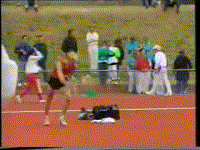

Showing: Basketball


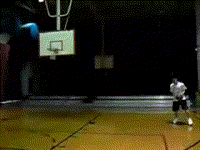

Showing: TennisSwing


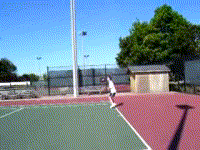



Category: CleanAndJerk | Sample Video: v_CleanAndJerk_g04_c02.avi
Category: PushUps | Sample Video: v_PushUps_g18_c02.avi
Category: JumpingJack | Sample Video: v_JumpingJack_g08_c03.avi

--- Displaying 3 GIFs ---
Showing: CleanAndJerk


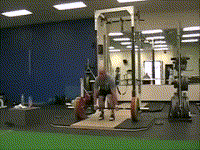

Showing: PushUps


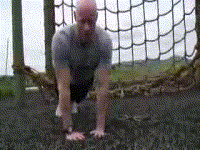

Showing: JumpingJack


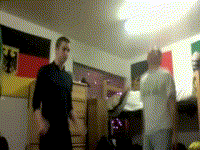



Category: SkateBoarding | Sample Video: v_SkateBoarding_g16_c02.avi
Category: TrampolineJumping | Sample Video: v_TrampolineJumping_g02_c05.avi
Category: Lunges | Sample Video: v_Lunges_g01_c07.avi

--- Displaying 3 GIFs ---
Showing: SkateBoarding


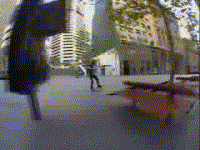

Showing: TrampolineJumping


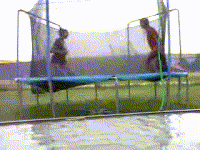

Showing: Lunges


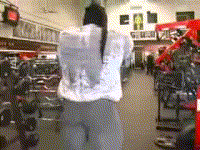



Category: GolfSwing | Sample Video: v_GolfSwing_g17_c06.avi

--- Displaying Remaining GIFs ---
Showing: GolfSwing


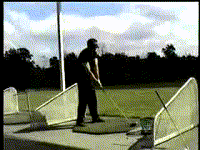

In [5]:
import os
import warnings
import tempfile
from IPython.display import Image, display
from moviepy.editor import VideoFileClip

# Suppress all warnings
warnings.filterwarnings('ignore')

# Define the body-motion only categories
body_motion_categories = [
    'HighJump', 'Basketball', 'TennisSwing', 'CleanAndJerk', 'PushUps', 'JumpingJack', 'SkateBoarding', 'TrampolineJumping', 'Lunges', 'GolfSwing'
]

# Base path to the UCF50 dataset on Kaggle
base_path = '/kaggle/input/ucf50-latest-version/UCF50/'

# Function to convert a video to GIF with error handling
def video_to_gif(video_path):
    try:
        # Use temporary directory compatible with Kaggle
        with tempfile.NamedTemporaryFile(suffix='.gif', delete=False) as tmp_file:
            gif_filename = tmp_file.name
        
        # Load video, take first 5 seconds, and resize for efficiency
        clip = VideoFileClip(video_path, verbose=False).subclip(0, min(5, VideoFileClip(video_path).duration))
        clip = clip.resize(width=200)  # Smaller width for side-by-side fit
        clip.write_gif(gif_filename, fps=10, program='ffmpeg', logger=None)  # Use FFmpeg, suppress logs
        clip.close()  # Close to free resources
        return gif_filename
    except Exception as e:
        print(f"Error converting {video_path} to GIF: {e}")
        return None

# Collect and display GIFs in groups of 3
row_gifs = []
for category in body_motion_categories:
    category_path = os.path.join(base_path, category)
    # Get list of .avi files
    avi_files = [f for f in os.listdir(category_path) if f.endswith('.avi')]
    if avi_files:
        sample_video = os.path.join(category_path, avi_files[0])  # Pick first video
        print(f"Category: {category} | Sample Video: {os.path.basename(sample_video)}")
        gif_filename = video_to_gif(sample_video)
        if gif_filename and os.path.exists(gif_filename):
            row_gifs.append((category, gif_filename))
        else:
            print(f"Failed to generate GIF for {sample_video}")
    else:
        print(f"No .avi files found in {category_path}")
    
    if len(row_gifs) == 3:
        # Display three GIFs with labels
        print("\n--- Displaying 3 GIFs ---")
        for cat, gif in row_gifs:
            print(f"Showing: {cat}")
            display(Image(filename=gif, width=200))  # Set width to fit notebook
            os.remove(gif)  # Clean up temporary file
        row_gifs = []
        print("\n")

# Display any remaining GIFs
if row_gifs:
    print("\n--- Displaying Remaining GIFs ---")
    for cat, gif in row_gifs:
        print(f"Showing: {cat}")
        display(Image(filename=gif, width=200))
        os.remove(gif)  # Clean up temporary file
    print("\n")

Category: HulaHoop
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/HulaHoop/v_HulaHoop_g12_c06.avi


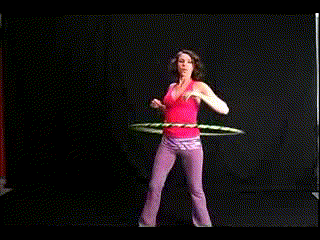

Category: JumpRope
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/JumpRope/v_JumpRope_g04_c06.avi


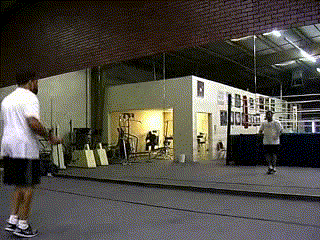

Category: JumpingJack
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/JumpingJack/v_JumpingJack_g08_c03.avi


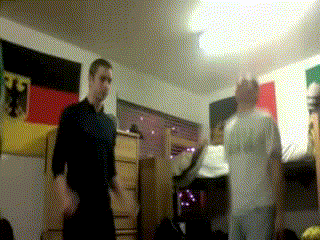

Category: Lunges
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/Lunges/v_Lunges_g01_c07.avi


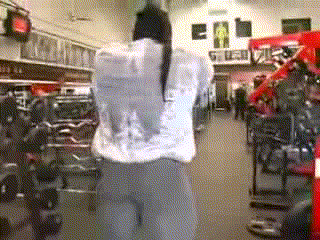

Category: PullUps
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/PullUps/v_Pullup_g14_c04.avi


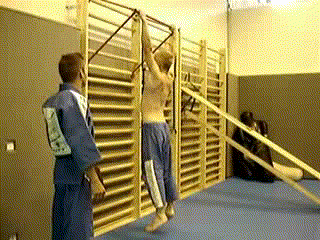

Category: PushUps
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/PushUps/v_PushUps_g18_c02.avi


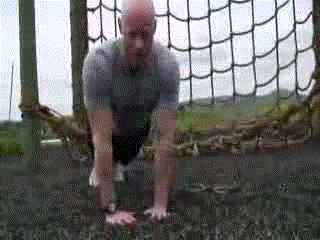

Category: TaiChi
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/TaiChi/v_TaiChi_g09_c02.avi


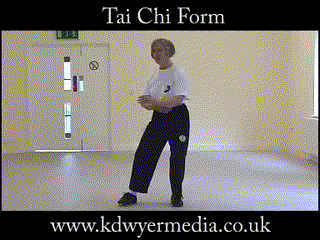

Category: HighJump
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/HighJump/v_HighJump_g19_c05.avi


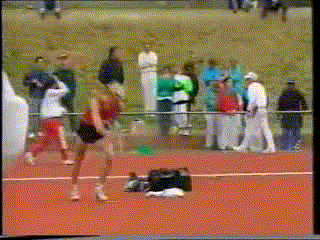

Category: Punch
Sample Video: /kaggle/input/ucf50-latest-version/UCF50/Punch/v_Punch_g02_c01.avi


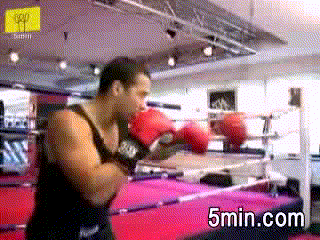

In [4]:
import os
import warnings
import tempfile
from IPython.display import Image, display
from moviepy.editor import VideoFileClip

# Suppress all warnings
warnings.filterwarnings('ignore')

# Define the body-motion only categories
body_motion_categories = [
    'HulaHoop', 'JumpRope', 'JumpingJack', 'Lunges', 'PullUps', 'PushUps', 'TaiChi', 'HighJump', 'Punch'
]

# Base path to the UCF50 dataset on Kaggle
base_path = '/kaggle/input/ucf50-latest-version/UCF50/'

# Function to convert a video to GIF with error handling
def video_to_gif(video_path):
    try:
        # Use temporary directory compatible with Kaggle
        with tempfile.NamedTemporaryFile(suffix='.gif', delete=False) as tmp_file:
            gif_filename = tmp_file.name
        
        # Load video, take first 5 seconds, and resize for efficiency
        clip = VideoFileClip(video_path, verbose=False).subclip(0, min(5, VideoFileClip(video_path).duration))
        clip = clip.resize(width=320)  # Reduce size for faster processing
        clip.write_gif(gif_filename, fps=10, program='ffmpeg', logger=None)  # Use FFmpeg, suppress logs
        clip.close()  # Close to free resources
        return gif_filename
    except Exception as e:
        print(f"Error converting {video_path} to GIF: {e}")
        return None

# Display one sample video (as GIF) from each category
for category in body_motion_categories:
    category_path = os.path.join(base_path, category)
    # Get list of .avi files
    avi_files = [f for f in os.listdir(category_path) if f.endswith('.avi')]
    if avi_files:
        sample_video = os.path.join(category_path, avi_files[0])  # Pick first video
        print(f"Category: {category}")
        print(f"Sample Video: {sample_video}")
        gif_filename = video_to_gif(sample_video)
        if gif_filename and os.path.exists(gif_filename):
            display(Image(filename=gif_filename))
            os.remove(gif_filename)  # Clean up temporary file
        else:
            print(f"Failed to generate GIF for {sample_video}")
    else:
        print(f"No .avi files found in {category_path}")